In [1]:
# those old useful libraries!
import numpy as np
import cv2
import os, glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pickle
import math
from collections import deque

from moviepy.editor import VideoFileClip
from IPython.display import HTML
import imageio

%matplotlib inline
%matplotlib qt

### 1. Camera Calibration
With the following methods {prepare_calibration() and image_calibration() } the camera will be calibrated. For that a list of chess boards photos which are taken from different angles and in different sizes. The gained information is used to calibrate the camera for our purpose.  

In [2]:
# preparing information to calibrate the camera
def prepare_calibration(path = 'camera_cal/calibration*.jpg'):
    # Make a list of calibration images
    images = glob.glob(path)
 
    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp = np.zeros((6*9,3), np.float32)
    objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1,2)

    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane.

    # Step through the list and search for chessboard corners
    for fname in images:
        img = cv2.imread(fname) # BGR 2 GRAY
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (9,6), None)

        # If found, add object points, image points
        if ret == True:
            objpoints.append(objp)
            imgpoints.append(corners)

            # Draw and display the corners
            cv2.drawChessboardCorners(img, (9,6), corners, ret)
            #write_name = 'corners_found'+str(idx)+'.jpg'
            #cv2.imwrite(write_name, img)
            cv2.imshow('img', img)
            cv2.waitKey(500)

    cv2.destroyAllWindows()
    return objpoints, imgpoints

In [3]:
# Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
def image_calibration(image, objpoints, imgpoints):
    # Test undistortion on an image
                # x axis    y axis
    img_size = (image.shape[1], image.shape[0])
    # Do camera calibration given object points and image points
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)

    # Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
    dist_pickle = {}
    dist_pickle["mtx"]  = mtx
    dist_pickle["dist"] = dist
    dist_pickle["objpoints"] = objpoints
    dist_pickle["imgpoints"] = imgpoints
    pickle.dump( dist_pickle, open( "dist_pickle.p", "wb" ) )   

In [4]:
# call the prepare_calibration, read one of calibration fotos to save the calibration data under dist_pickle.p 
objpoints, imgpoints = prepare_calibration(path = 'camera_cal/calibration*.jpg')
image = cv2.imread('camera_cal/calibration1.jpg')
image_calibration(image, objpoints, imgpoints)

### 2. Undistortion
With this method with the help of calibration parameters the distortion effects of the camera lens are compromised.

In [5]:
# Apply a distortion correction to raw images.
def undistort(image,pickle_path="dist_pickle.p"):
    # Read in the saved objpoints and imgpoints
    dist_pickle = pickle.load( open(pickle_path, "rb" ) )
    mtx  = dist_pickle["mtx"]
    dist = dist_pickle["dist"]    
    objpoints = dist_pickle["objpoints"]
    imgpoints = dist_pickle["imgpoints"]
    dst = cv2.undistort(image, mtx, dist, None, mtx)
    return dst

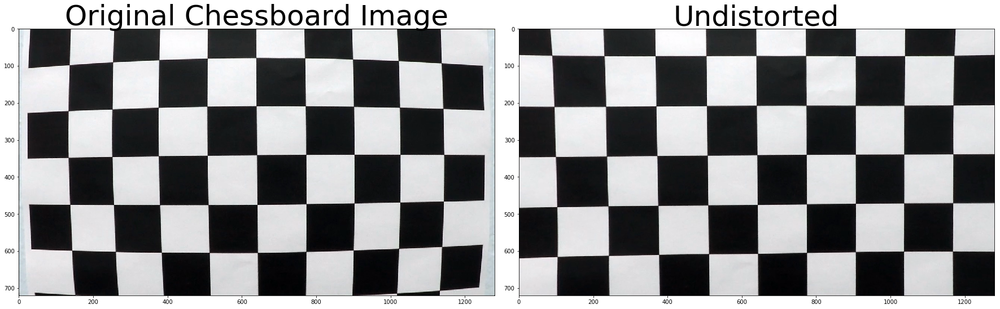

In [6]:
# shwoing one example of chess board images in original and undistorted version
img = cv2.imread("camera_cal/calibration1.jpg")
dst = undistort(img)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Chessboard Image', fontsize=50)
ax2.imshow(dst)
ax2.set_title('Undistorted', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

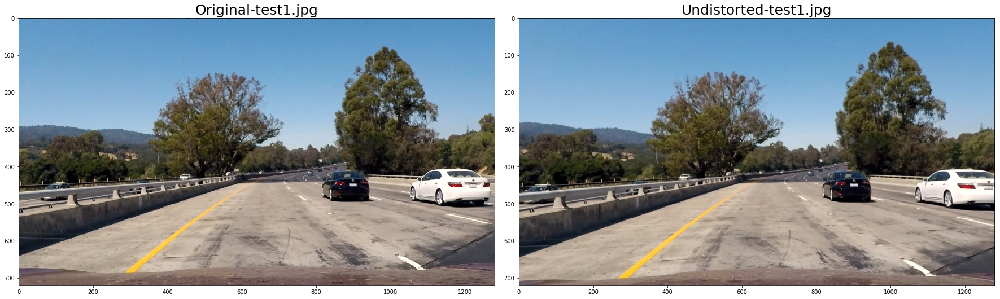

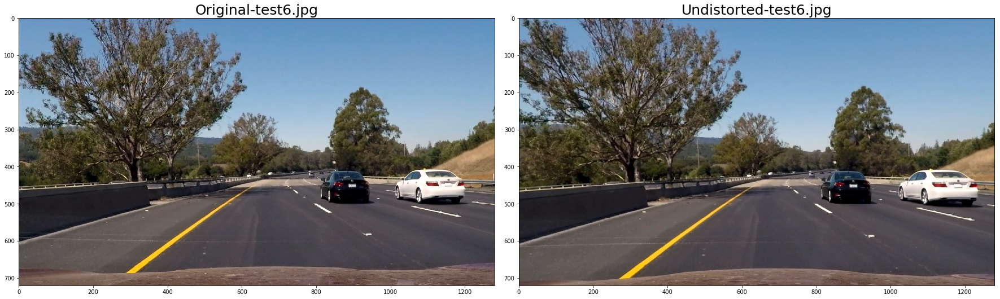

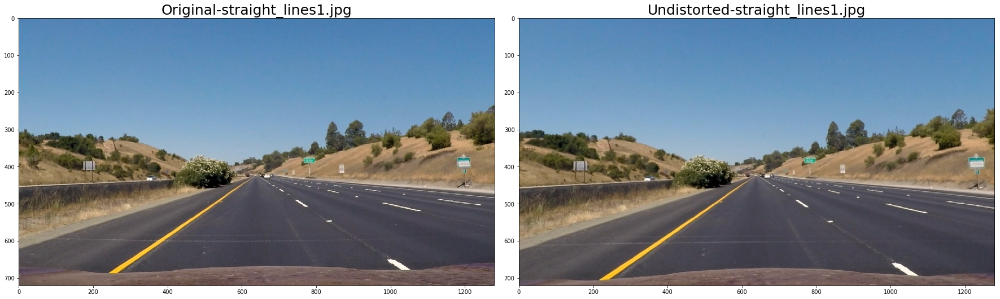

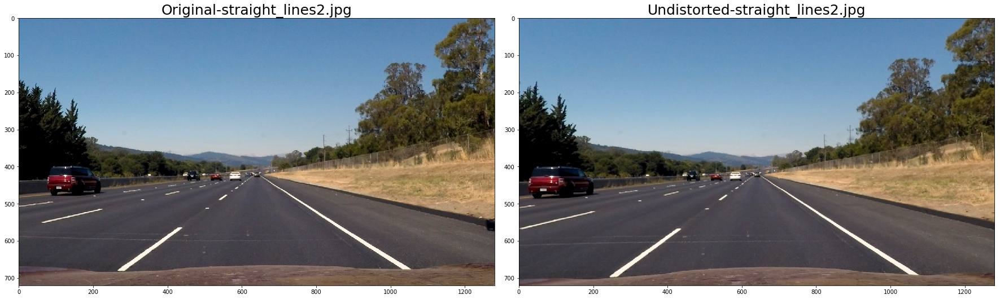

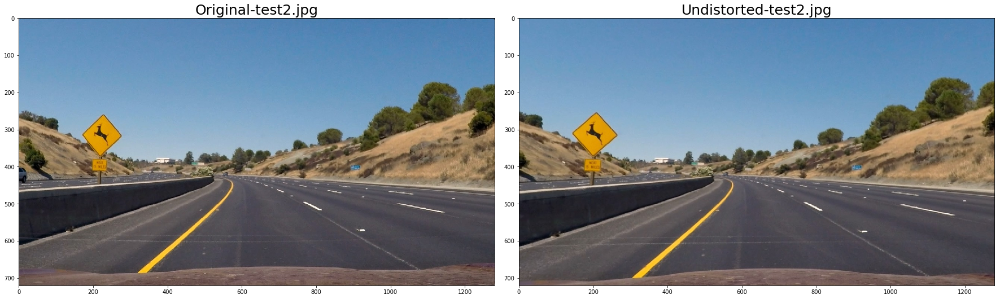

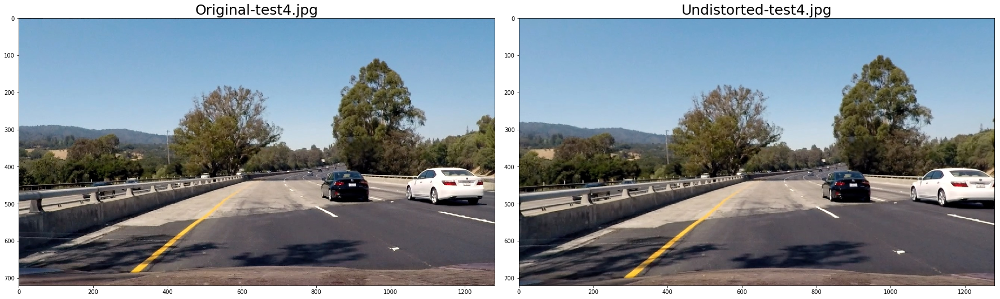

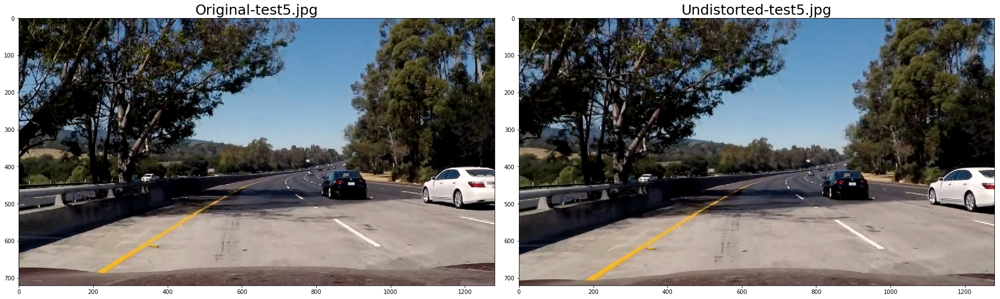

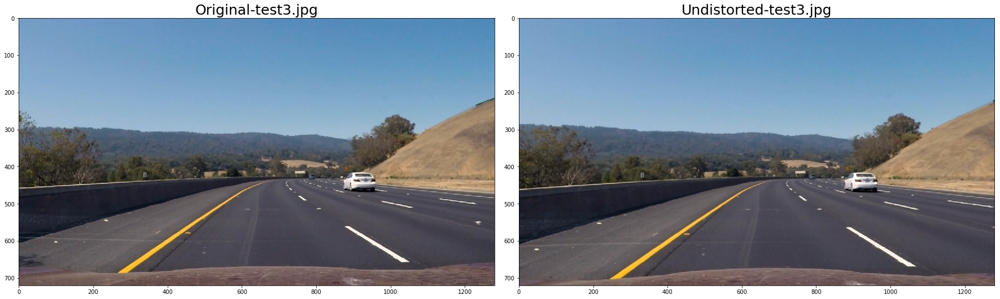

In [7]:
# images path (list of all test images) 
images = glob.glob('test_images/*.jpg')
# saving results path
output_dst = 'output_images/'   
for path in images:
    image = cv2.imread(path)
    image_name = os.path.basename(path)
    # call the calibration prepairing method 
    dst = undistort(image)
    # save the undistorted image in output_images folder
    cv2.imwrite(output_dst+"_undistorted_"+image_name, dst)
    
    dst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original-' + image_name, fontsize=25)
    ax2.imshow(dst)
    ax2.set_title('Undistorted-' + image_name, fontsize=25)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)    

### 3. Binary Image
In this section I used three different color space to mark out the yellow and white lane lines. In all methods after recognizing the both lanes the binary matrix is combined. The color spaces are RGB, HLS and CMYK. The threshold values are set by playing around with the values here : http://colorizer.org/ . It is worthy to mention that the yellow lane line is not so yellowish and have plenty red color too. Which makes it more orange. At the end all binary gained images are combined and mixed with gained binary from sobel.

In [8]:
# detect the yellow lane line at the RGB color-space and make the binary of that image
def yellow_RGB_select(image):
    # Convert to RGB color space and separate the S channel
    # Note: img is the undistorted image
    yellow_RGB_binary = np.zeros_like(image[:,:,2])
    
    R_channel = image[:,:,0]
    G_channel = image[:,:,1]
    B_channel = image[:,:,2]

    # Threshold color channel
    R_thresh_min = 225
    R_thresh_max = 255
    
    G_thresh_min = 180
    G_thresh_max = 255   
    
    B_thresh_min = 0
    B_thresh_max = 170
    
    R_binary = np.zeros_like(R_channel)
    R_binary[(R_channel > R_thresh_min) & (R_channel <= R_thresh_max)] = 1
    G_binary = np.zeros_like(G_channel)
    G_binary[(G_channel > G_thresh_min) & (G_channel <= G_thresh_max)] = 1    
    B_binary = np.zeros_like(B_channel)    
    B_binary[(B_channel > B_thresh_min) & (B_channel <= B_thresh_max)] = 1
        
    yellow_RGB_binary[(R_binary == 1) & (G_binary == 1) & (B_binary == 1)] = 1    
    return yellow_RGB_binary

In [9]:
# detect the white lane line at the RGB color-space and make the binary of that image
def white_RGB_select(image):
    # Convert to RGB color space and separate the S channel
    # Note: img is the undistorted image
    white_RGB_binary = np.zeros_like(image[:,:,2])
    
    R_channel = image[:,:,0]
    G_channel = image[:,:,1]
    B_channel = image[:,:,2]
    # Threshold color channel
    R_thresh_min = 100
    R_thresh_max = 255
    
    G_thresh_min = 100
    G_thresh_max = 255   
    
    B_thresh_min = 200
    B_thresh_max = 255
    
    R_binary = np.zeros_like(R_channel)
    R_binary[(R_channel > R_thresh_min) & (R_channel <= R_thresh_max)] = 1
    G_binary = np.zeros_like(G_channel)
    G_binary[(G_channel > G_thresh_min) & (G_channel <= G_thresh_max)] = 1    
    B_binary = np.zeros_like(B_channel)    
    B_binary[(B_channel > B_thresh_min) & (B_channel <= B_thresh_max)] = 1
    
    white_RGB_binary[(R_binary == 1) & (G_binary == 1) & (B_binary == 1)] = 1
    return white_RGB_binary

In [10]:
# detect the yellow lane line at the HLS color-space and make the binary of that image
def yellow_hls_select(image):
    # Convert to HLS color space and separate the S channel
    # Note: img is the undistorted image
    yellow_HLS_binary = np.zeros_like(image[:,:,2])
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    h_channel = hls[:,:,0]
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    # Threshold color channel
    h_thresh_min = 17
    h_thresh_max = 40
    
    l_thresh_min = 55
    l_thresh_max = 215   
    
    s_thresh_min = 80
    s_thresh_max = 204
    
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel > s_thresh_min) & (s_channel <= s_thresh_max)] = 1
    l_binary = np.zeros_like(l_channel)
    l_binary[(l_channel > l_thresh_min) & (l_channel <= l_thresh_max)] = 1    
    h_binary = np.zeros_like(h_channel)    
    h_binary[(h_channel > h_thresh_min) & (h_channel <= h_thresh_max)] = 1
    
    yellow_HLS_binary[(h_binary == 1) & (l_binary == 1) & (s_binary == 1)] = 1
    return yellow_HLS_binary

In [11]:
# detect the white lane line at the HLS color-space and make the binary of that image
def white_hls_select(image):
    # Convert to HLS color space and separate the S channel
    # Note: img is the undistorted image
    white_HLS_binary = np.zeros_like(image[:,:,2])
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    h_channel = hls[:,:,0]
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
    # Threshold color channel
    h_thresh_min = 7
    h_thresh_max = 25
    
    l_thresh_min = 200
    l_thresh_max = 255    
   
    s_thresh_min = 0
    s_thresh_max = 40
    
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel > s_thresh_min) & (s_channel <= s_thresh_max)] = 1
    l_binary = np.zeros_like(l_channel)
    l_binary[(l_channel > l_thresh_min) & (l_channel <= l_thresh_max)] = 1    
    h_binary = np.zeros_like(h_channel)    
    h_binary[(h_channel > h_thresh_min) & (h_channel <= h_thresh_max)] = 1
    
    white_HLS_binary[(h_binary == 1) & (l_binary == 1) & (s_binary == 1)] = 1
    return white_HLS_binary

In [12]:
# detect the yellow lane line at the CMYK color-space and make the binary of that image
def yellow_CMYK_select(image):
    yellow_CMYK_binary = np.zeros_like(image[:,:,2])

    R_channel = image[:,:,0]
    G_channel = image[:,:,1]
    B_channel = image[:,:,2]
    
    cmyk_scale = 255
    def rgb_to_cmyk(R_channel,G_channel,B_channel):
        # rgb [0,255] -> cmy [0,1]
        c = 1 - R_channel / 255
        m = 1 - G_channel / 255
        y = 1 - B_channel / 255
        min_cmy = min(c.min(), m.min(), y.min())
        c = (c - min_cmy) / (1 - min_cmy)
        m = (m - min_cmy) / (1 - min_cmy)
        y = (y - min_cmy) / (1 - min_cmy)
        k = min_cmy
        # rescale to the range [0,cmyk_scale]
        return c*cmyk_scale, m*cmyk_scale, y*cmyk_scale, k*cmyk_scale
    
    c_cmyk_scale, m_cmyk_scale, y_cmyk_scale, k_cmyk_scale = rgb_to_cmyk(R_channel,G_channel,B_channel)
    
    c_thresh_min = 0
    c_thresh_max = 25
    m_thresh_min = 0
    m_thresh_max = 255    
    y_thresh_min = 0
    y_thresh_max = 255    
    
    c_binary = np.zeros_like(R_channel)
    c_binary[(c_cmyk_scale > c_thresh_min) & (c_cmyk_scale <= c_thresh_max)] = 1
    m_binary = np.zeros_like(G_channel)
    m_binary[(m_cmyk_scale > m_thresh_min) & (m_cmyk_scale <= m_thresh_max)] = 1    
    y_binary = np.zeros_like(B_channel)
    y_binary[(y_cmyk_scale > y_thresh_min) & (y_cmyk_scale <= y_thresh_max)] = 1
    
    yellow_CMYK_binary[(c_binary == 1) & (m_binary == 1) & (y_binary == 1)] = 1

    return yellow_CMYK_binary

In [13]:
# combine the all color-space gained binary images
def combine_yellow_white_hls(image):
    white_HLS_binary  = white_hls_select(image)
    yellow_HLS_binary = yellow_hls_select(image)
    
    yellow_RGB_binary = yellow_RGB_select(image)
    white_RGB_binary  = white_RGB_select(image)
    
    yellow_CMYK_binary = yellow_CMYK_select(image)
    
    combined_colors = np.zeros_like(image[:,:,2])
    combined_colors[(yellow_CMYK_binary==1) | (yellow_HLS_binary==1) | (white_HLS_binary==1) | (yellow_RGB_binary==1) | (white_RGB_binary==1)] = 1
    return combined_colors

In [14]:
# Use color transforms, gradients, etc., to create a thresholded binary image.
def color_select(image):
    # Grayscale image
    # NOTE: we already saw that standard grayscaling lost color information for the lane lines
    # Explore gradients in other colors spaces / color channels to see what might work better
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    # Sobel x
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx   = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    # Threshold x gradient
    thresh_min = 20
    thresh_max = 150
    sxbinary   = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel > thresh_min) & (scaled_sobel <= thresh_max)] = 1
    
    combined_colors = np.zeros_like(image[:,:,2])
    combined_colors = combine_yellow_white_hls(image)
    
    # Combine the two binary thresholds
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(sxbinary == 1) | (combined_colors == 1)] = 1
    #combined_binary[(combined_colors == 1) ] = 1
    return combined_binary    

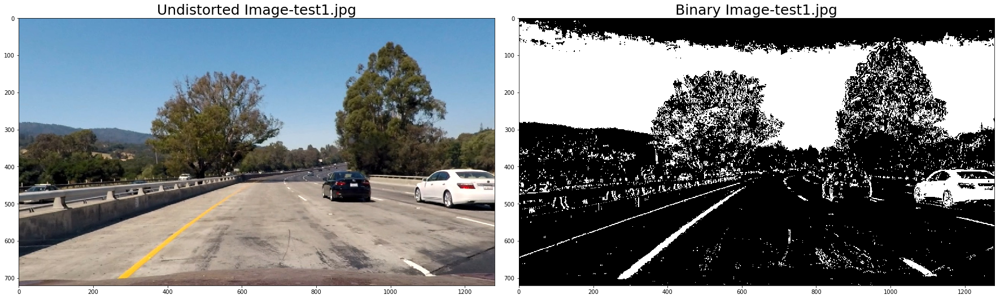

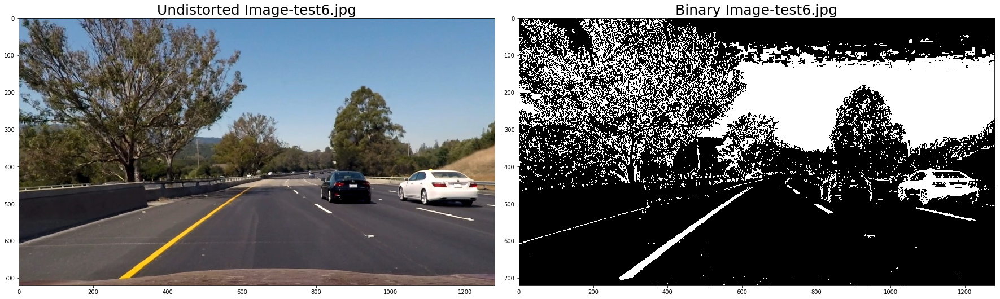

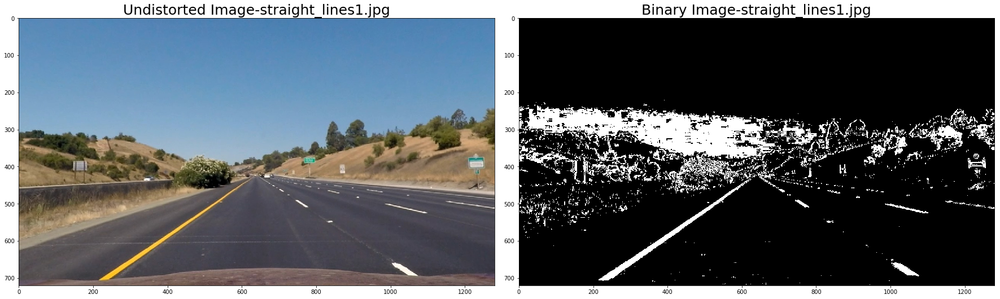

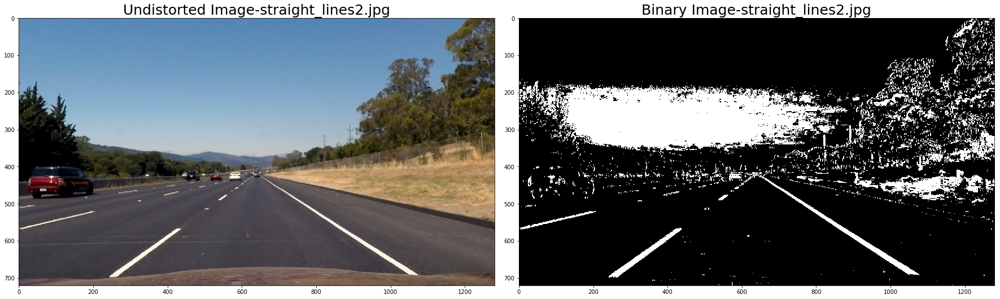

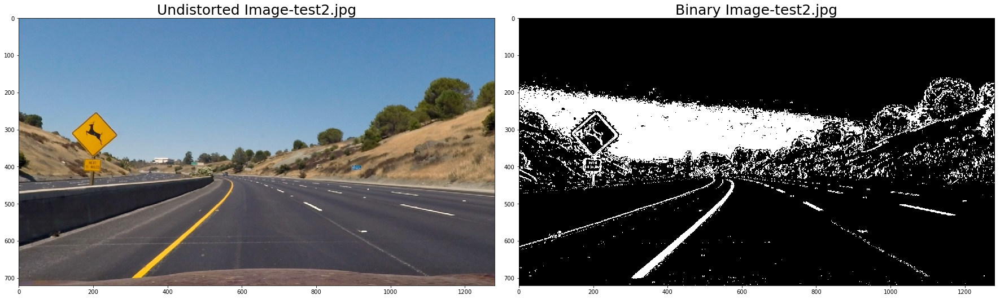

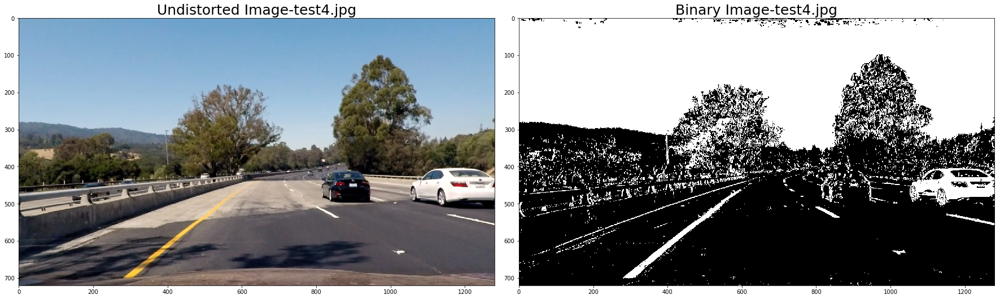

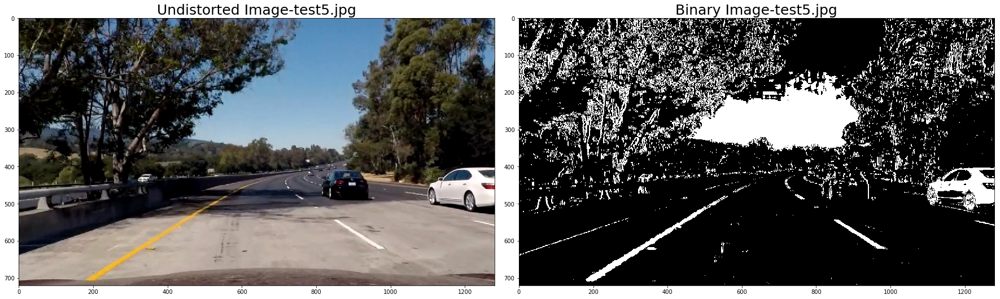

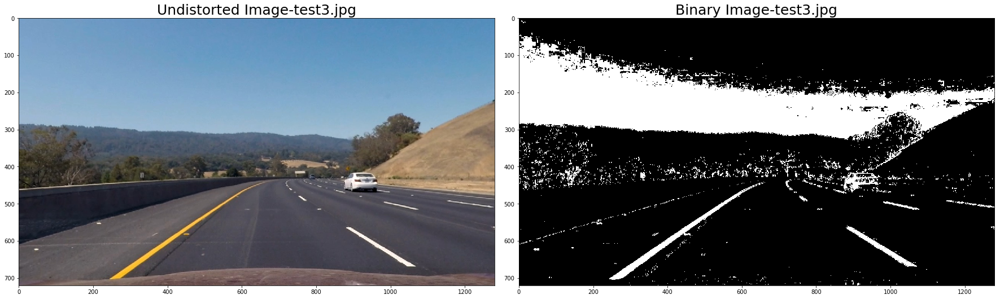

In [15]:
# save the combined_binary fotos in output_images directory
images = glob.glob('test_images/*.jpg')
output_dst = 'output_images/' 
for path in images:
    image = mpimg.imread(path)
    image = undistort(image)
    combined_binary = color_select(image)
    image_name = os.path.basename(path)
    # multiply with 255 as it is binary (0,1) and or showing this is needed 
    cv2.imwrite(output_dst+"_combined_binary_"+image_name, combined_binary*255)
    dst = combined_binary*255
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Undistorted Image-' + image_name, fontsize=25)
    ax2.imshow(dst, cmap='Greys_r')
    ax2.set_title('Binary Image-' + image_name, fontsize=25)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.) 

### 4. Birds-Eye View transformation
Whit this method the image perspective is transformed to the bird eye view.

In [16]:
# Apply a perspective transform to rectify binary image
# ("birds-eye view")

def birds_eye_view(combined_binary):    
    #img_size = binary_image.shape[::-1] # (width,height)
    img_size = (combined_binary.shape[0], combined_binary.shape[1])
    offset   = 50
    
    left_b   = (0.1875 * img_size[1], img_size[0]- offset)
    src_L_up = (img_size[1]/2 - offset , img_size[0]/2 + offset+35 )
    src_R_up = (img_size[1]/2 + offset, img_size[0]/2 + offset+35 )
    right_b  = (0.8125 * img_size[1], img_size[0]- offset)

    src = np.float32([ [left_b,src_L_up,src_R_up,right_b]])
    #print(src)
    
    dst_left_b  = (0.1875 * img_size[1] + offset, img_size[0]) #0,1875
    dst_L_up    = (0.1875 * img_size[1] + offset, 0)
    dst_R_up    = (0.8125 * img_size[1] - offset, 0)
    dst_right_b = (0.8125 * img_size[1] - offset, img_size[0]) #0.8125
    
    dst = np.float32([[dst_left_b, dst_L_up, dst_R_up, dst_right_b]])
    #print(dst)
    
    M = cv2.getPerspectiveTransform(src, dst)
    Revers_M = cv2.getPerspectiveTransform(dst, src)
    
    img_shape = combined_binary.shape[::-1]
    
    warped = cv2.warpPerspective(combined_binary, M, img_shape, flags=cv2.INTER_LINEAR)
    # warped is the transformed image
    # M is the transformed matrix
    # reversed of M matrix
    return warped, M , Revers_M

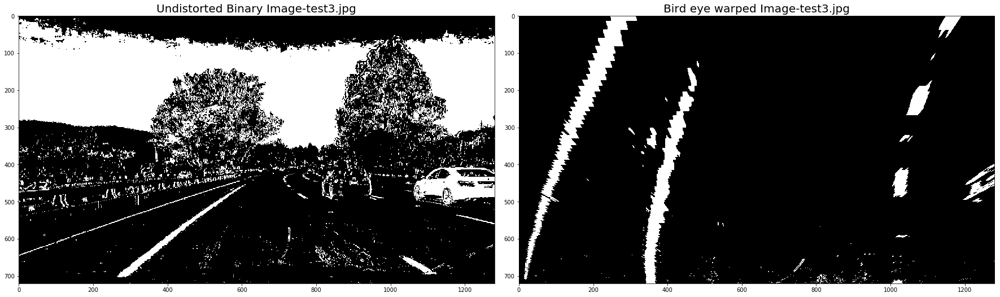

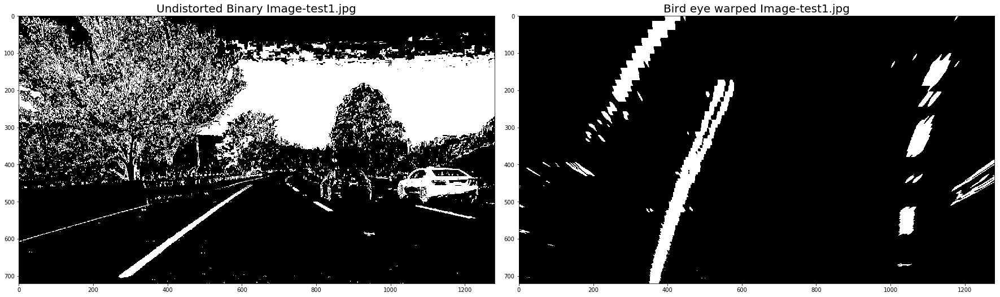

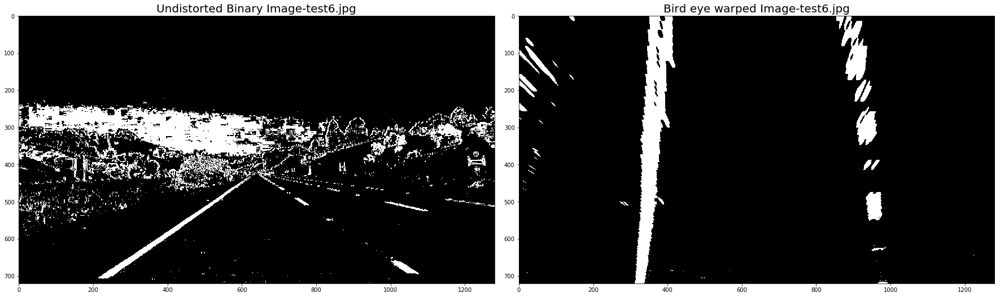

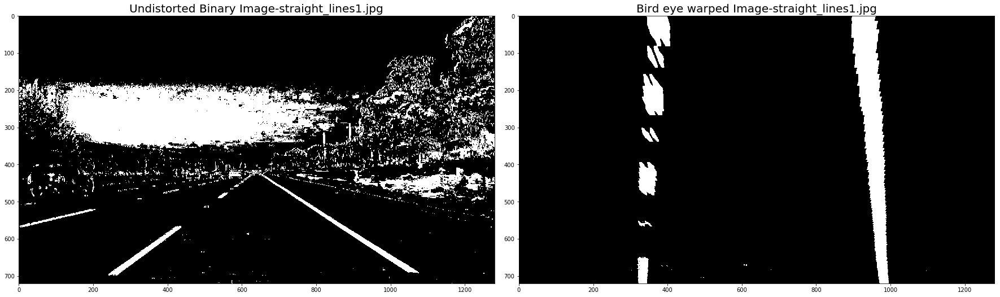

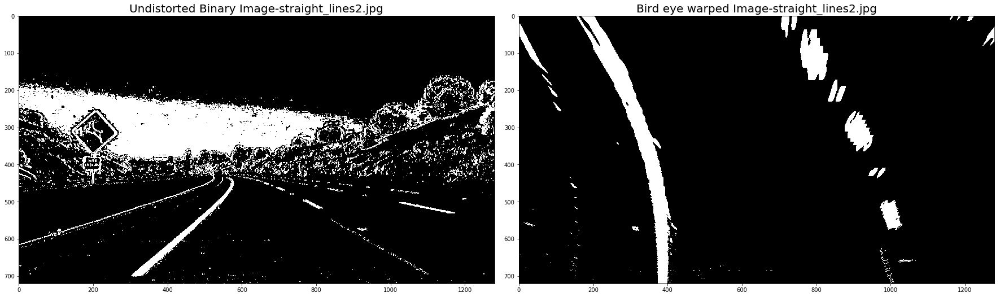

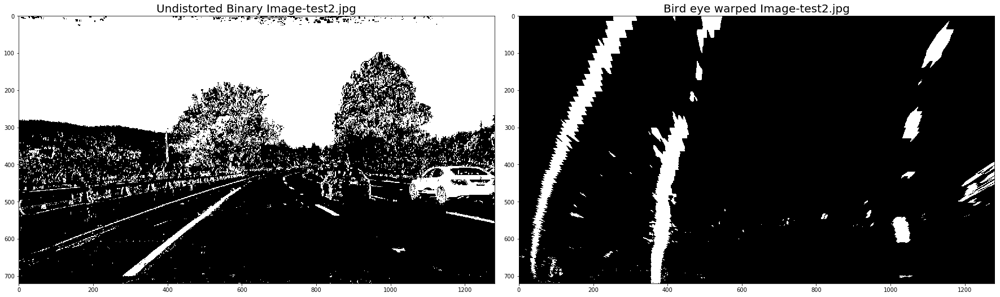

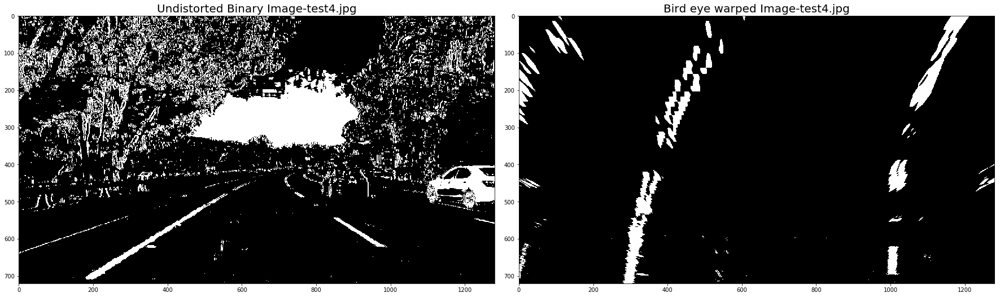

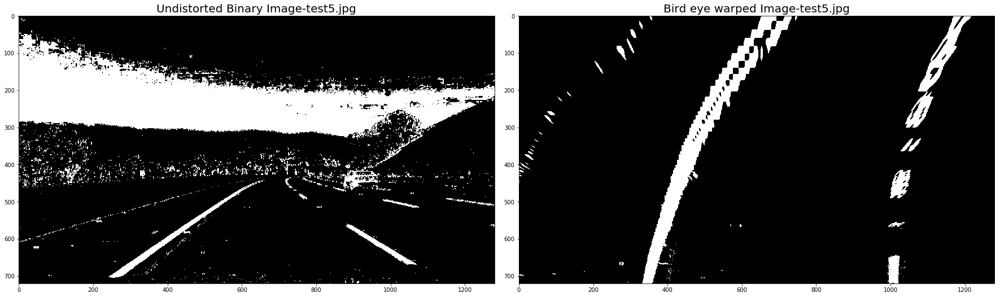

In [17]:
# save the transformed ("birds-eye view") fotos in output_images directory
images = glob.glob('test_images/*.jpg')
output_dst = 'output_images/' 

for path in images:
    image = mpimg.imread(path)
    image = undistort(image)
    combined_binary = color_select(image)
    top_down, perspective_M, Revers_M = birds_eye_view(combined_binary)
    # showing the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(combined_binary, cmap='Greys_r')
    ax1.set_title('Undistorted Binary Image-'+image_name, fontsize=20)
    ax2.imshow(top_down, cmap='Greys_r')
    ax2.set_title('Bird eye warped Image-'+image_name, fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    image_name = os.path.basename(path)
    # multiply with 255 as it is binary (0,1) and or showing this is needed 
    cv2.imwrite(output_dst+"_transformed_"+image_name, top_down*255)

### 5. Find Lane Pixels
This method finds the lane lines by limiting the area of search to defined so called windows from bottom to up. To place the first window it uses histogram and place the first window at the peaks, left and right side separated. The rest of the lane will be covered over the rest windows putting on each other following the lane lines.

In [18]:
# Detect lane pixels and fit to find the lane boundary.

def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    fit_image = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base  = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero  = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds  = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low  = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        ### TO-DO: Find the four below boundaries of the window ###
        win_xleft_low   = leftx_current - margin # Update this
        win_xleft_high  = leftx_current + margin  # Update this
        win_xright_low  = rightx_current - margin  # Update this
        win_xright_high = rightx_current + margin  # Update this
        
        # Draw the windows on the visualization image
        cv2.rectangle(fit_image,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(fit_image,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        ### TO-DO: Identify the nonzero pixels in x and y within the window ###
        nonzero  = binary_warped.nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        good_left_inds = np.where( (nonzeroy >= win_y_low) & (nonzeroy < win_y_high) &
        (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high))[0]
        good_right_inds = np.where( (nonzerox>=win_xright_low) & (nonzerox<win_xright_high) & 
        (nonzeroy>win_y_low) & (nonzeroy<win_y_high) )[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        ### TO-DO: If you found > minpix pixels, recenter next window ###
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
        ### (`right` or `leftx_current`) on their mean position ###

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds  = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx  = nonzerox[left_lane_inds]
    lefty  = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, fit_image

In [19]:
def fit_polynomial(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, fit_image = find_lane_pixels(binary_warped)
    ### TO-DO: Fit a second order polynomial to each using `np.polyfit` ###
    left_fit  = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx  = left_fit[0]*ploty**2  + left_fit[1]*ploty  + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx  = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    fit_image[lefty, leftx]   = [255, 0, 0] # red
    fit_image[righty, rightx] = [0, 0, 255] # blue
    return ploty, fit_image, left_fit, right_fit, left_fitx, right_fitx

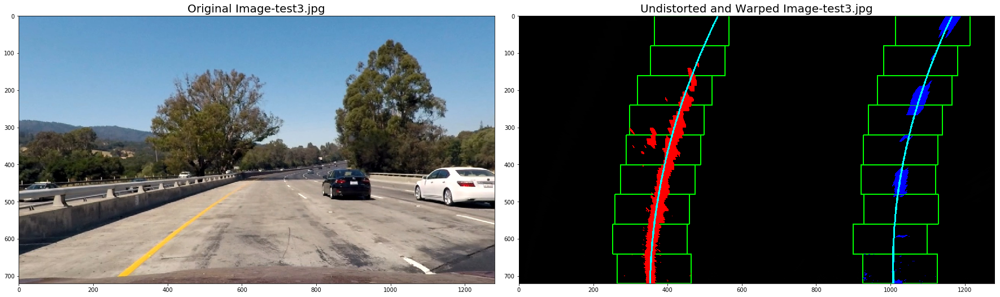

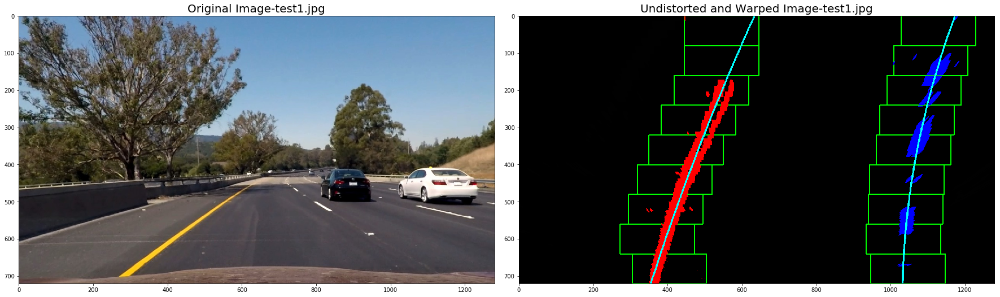

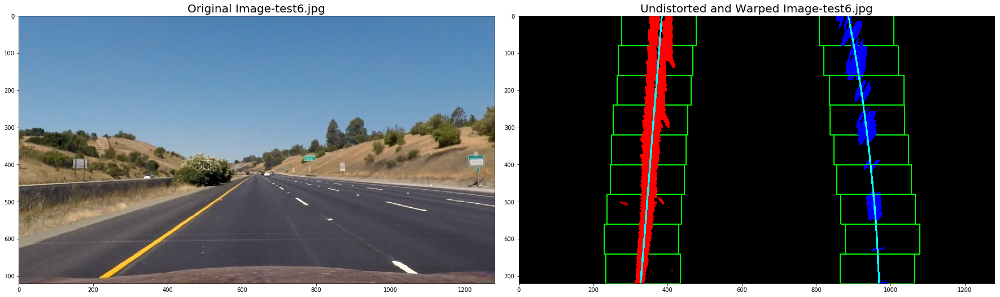

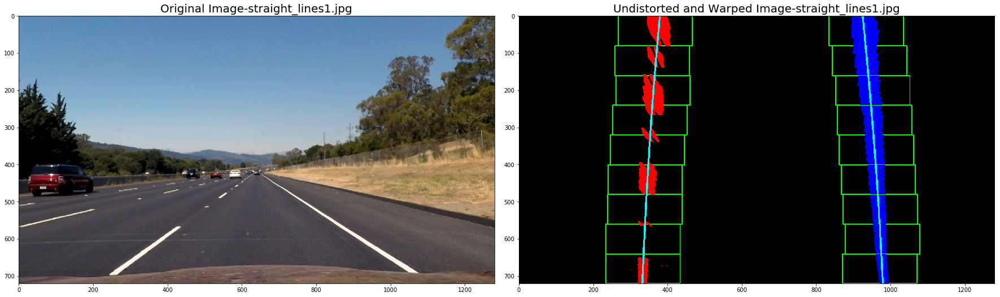

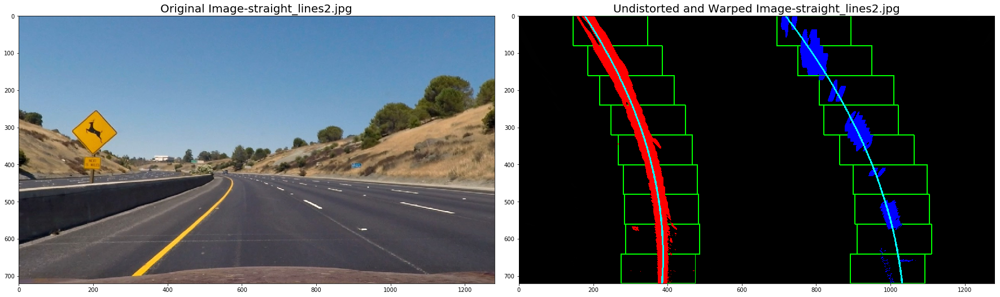

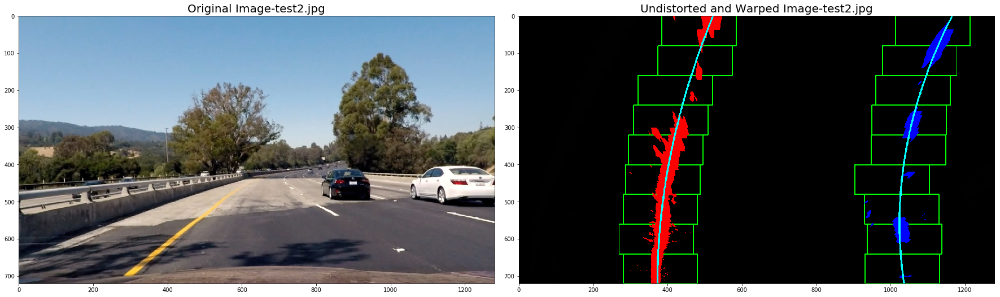

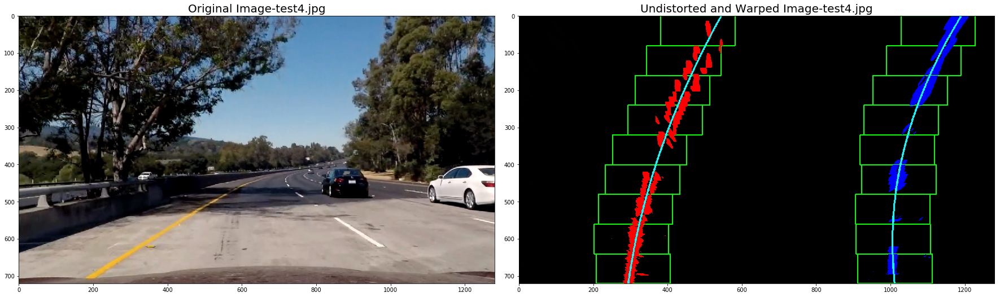

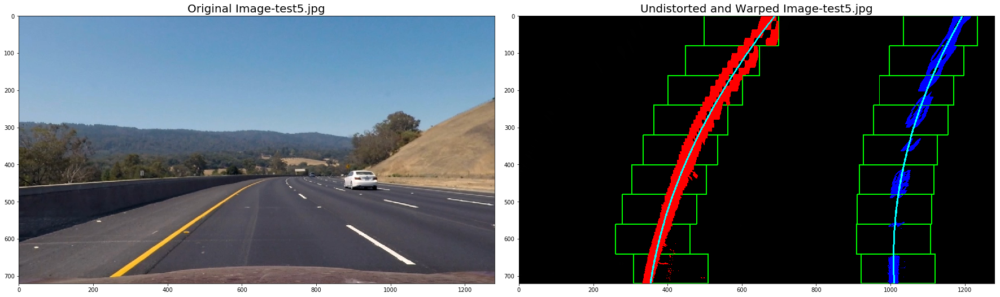

In [20]:
# call the fit_polynomial to draw a lines on detected lane lines
images = glob.glob('test_images/*.jpg')
output_dst = 'output_images/' 

for path in images:
    image = mpimg.imread(path)
    image = undistort(image)
    combined_binary = color_select(image)
    top_down, perspective_M , Revers_M = birds_eye_view(combined_binary)
    ploty, fit_image, left_fit, right_fit, left_fitx, right_fitx = fit_polynomial(top_down)
    left_points  = np.array(list(zip(left_fitx, ploty)), np.int32)
    right_points = np.array(list(zip(right_fitx, ploty)), np.int32)
    
    cv2.polylines(fit_image, [left_points], False, (0,255,255),4) # cyan polynom line 
    cv2.polylines(fit_image, [right_points], False, (0,255,255),4)

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image-'+image_name, fontsize=20)
    # show the result
    ax2.imshow(fit_image, cmap='Greys_r')
    ax2.set_title('Undistorted and Warped Image-'+image_name, fontsize=20)
#     ax2.plot(left_fitx, ploty, color='yellow')
#     ax2.plot(right_fitx, ploty, color='yellow')
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

    image_name = os.path.basename(path)
    # multiply with 255 as it is binary (0,1) and or showing this is needed 
    cv2.imwrite(output_dst+"_windows_lines_"+image_name, fit_image)

### 6. Curvature determination
Determine the curvature of the lane and vehicle position with respect to center. 

In [21]:
def generate_data(ym_per_pix, xm_per_pix,left_fitx, right_fitx, ploty, image):
    # Fit a second order polynomial to pixel positions in each fake lane line
    ##### TO-DO: Fit new polynomials to x,y in world space #####
    
    distance = (abs(left_fitx[-1] + right_fitx[-1]) / 2)* xm_per_pix
    image_center = abs(xm_per_pix * image.shape[1]/2)
    distancet_to_center = distance - image_center 
    
    left_fit_cr  = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)
    
    return ploty, left_fit_cr, right_fit_cr, distancet_to_center

In [22]:
# Determine the curvature of the lane and vehicle position with respect to center

def measure_curvature_real(left_fitx, right_fitx, ploty, image):

    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    # Start by generating our fake example data
    # Make sure to feed in your real data instead in your project!
    ploty, left_fit_cr, right_fit_cr, distancet_to_center = generate_data(ym_per_pix, xm_per_pix,left_fitx, right_fitx, ploty, image)
    
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    
    ##### TO-DO: Implement the calculation of R_curve (radius of curvature) #####
    left_curverad  = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])  ## Implement the calculation of the left line here
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])  ## Implement the calculation of the right line here
    return left_curverad, right_curverad, distancet_to_center

In [23]:
# to smooth the curvature on both side and set a limit to may allowed curvature
def smooth_curvature(left_curverad, right_curverad, max_curvature = 10000):
    curvature = (left_curverad + right_curverad)/2
    if curvature > max_curvature:
        return max_curvature
    if curvature > 1000:
        return (curvature / 100) * 100
    else:
        return (curvature / 50) * 50

In [24]:
# call the measure_curvature_real to calculate the real distance in meter from pixel world
# also print the left and right curvature and the distance from image center
images = glob.glob('test_images/*.jpg')
output_dst = 'output_images/' 

for path in images:
    image = mpimg.imread(path)
    image = undistort(image)
    combined_binary = color_select(image)
    top_down, perspective_M, Revers_M = birds_eye_view(combined_binary)
    ploty, fit_image, left_fit, right_fit, left_fitx, right_fitx = fit_polynomial(top_down)
    left_curverad, right_curverad, distancet_to_center = measure_curvature_real(left_fitx, right_fitx, ploty, image)
    image_name = os.path.basename(path)
    print(image_name)
    print('left curverad: '+str(round(left_curverad,3))+' [m]', 'right curverad: '+str(round(right_curverad,3))+' [m]')
    print("Distancet to center:", str(round(distancet_to_center,3))+' [m]')   

test1.jpg
left curverad: 500.874 [m] right curverad: 471.129 [m]
Distancet to center: 0.211 [m]
test6.jpg
left curverad: 1783.641 [m] right curverad: 685.006 [m]
Distancet to center: 0.283 [m]
straight_lines1.jpg
left curverad: 443677.955 [m] right curverad: 1486.365 [m]
Distancet to center: 0.041 [m]
straight_lines2.jpg
left curverad: 4263.697 [m] right curverad: 4607.405 [m]
Distancet to center: 0.082 [m]
test2.jpg
left curverad: 327.407 [m] right curverad: 359.838 [m]
Distancet to center: 0.358 [m]
test4.jpg
left curverad: 584.86 [m] right curverad: 360.936 [m]
Distancet to center: 0.337 [m]
test5.jpg
left curverad: 572.53 [m] right curverad: 329.985 [m]
Distancet to center: 0.065 [m]
test3.jpg
left curverad: 373.737 [m] right curverad: 380.942 [m]
Distancet to center: 0.22 [m]


### 7. Fill the boundaries
With the gained information the space inside the boundaries is filled with color to specify the interested driving region. This colored region then is drawn to the original undistorted image. 

In [25]:
# Draw the filling color at specified area  
def draw_filling(warped, left_fitx, right_fitx, ploty, image, Revers_M):
    # Create an image to draw the lines on
    temp = np.zeros_like(warped).astype(np.uint8)
    foto = np.dstack((temp, temp, temp))
    image_size = (image.shape[1], image.shape[0])
    # Recast the x and y points into usable format for cv2.fillPoly()
    left_points  = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    right_points = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    points = np.hstack((left_points, right_points))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(foto, np.int_([points]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(foto, Revers_M, image_size) 
    # Combine the result with the original image
    result = cv2.addWeighted(image, 1, newwarp, 0.3, 0)
    return result

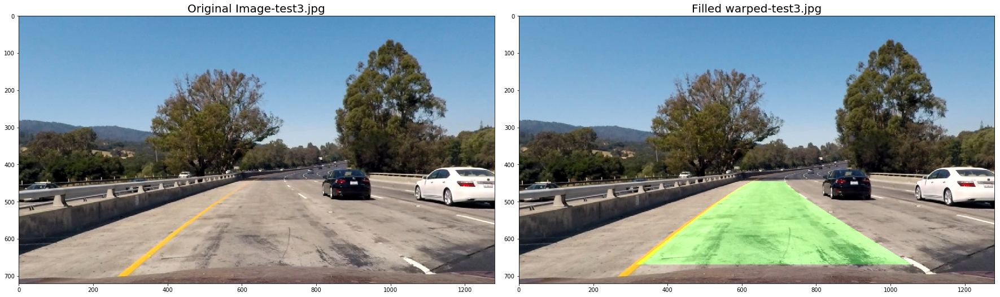

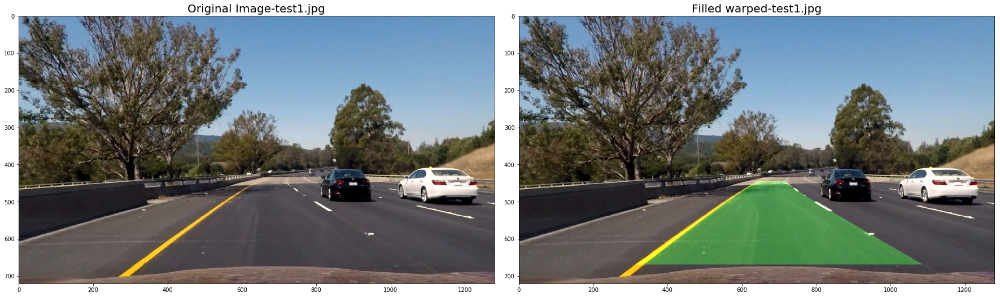

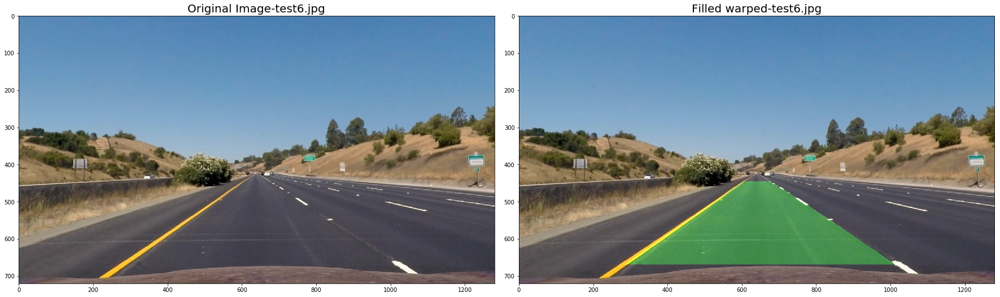

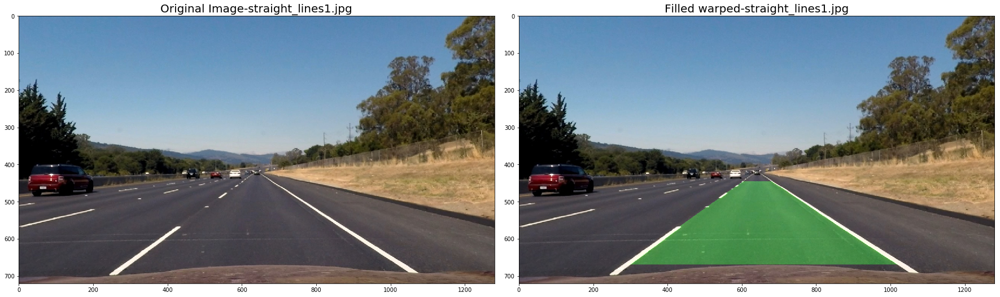

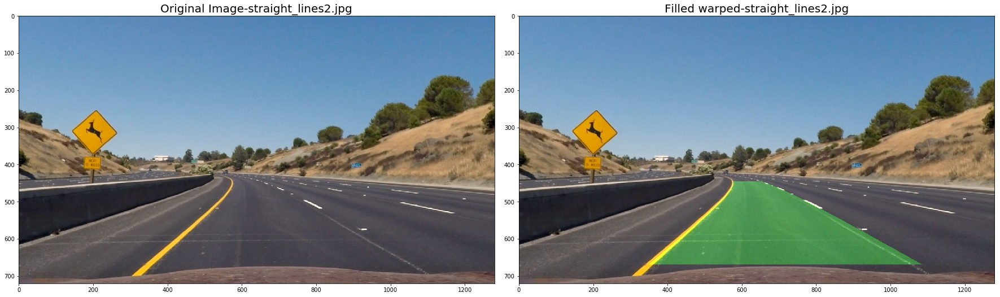

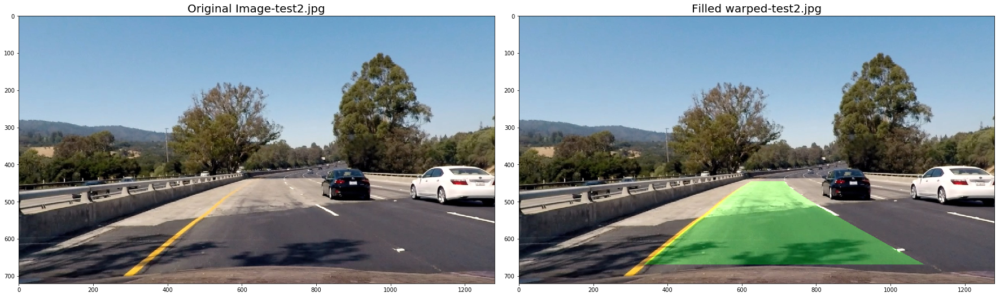

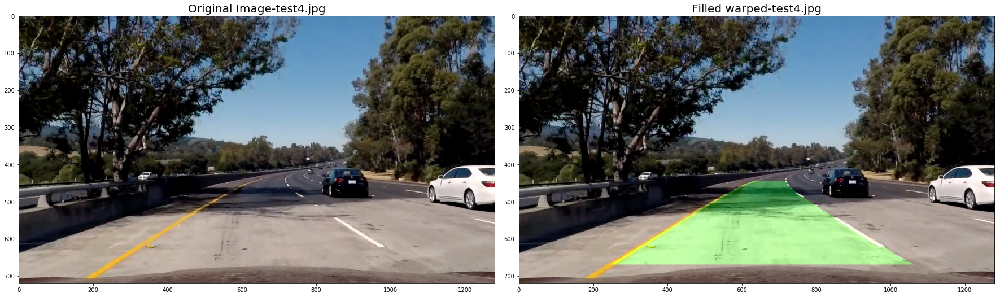

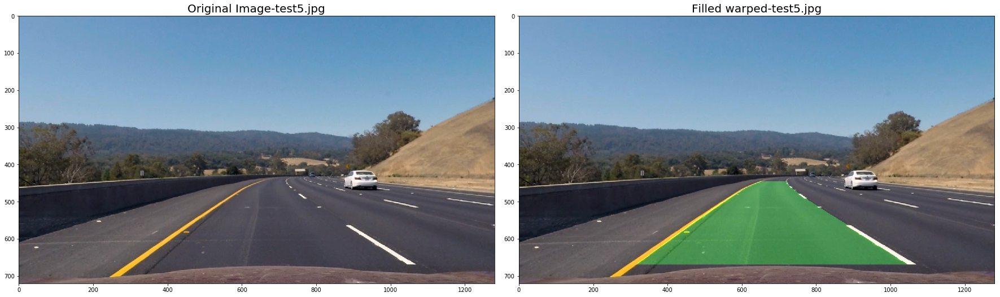

In [26]:
# Warp the detected lane boundaries back onto the original image.

images = glob.glob('test_images/*.jpg')
output_dst = 'output_images/' 

for path in images:
    image = mpimg.imread(path)
    image = undistort(image)
    combined_binary = color_select(image)
    warped, perspective_M, Revers_M = birds_eye_view(combined_binary)
    ploty, fit_image, left_fit, right_fit, left_fitx, right_fitx = fit_polynomial(warped)
    result = draw_filling(warped, left_fitx, right_fitx, ploty, image, Revers_M)

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image-'+image_name, fontsize=20)
    # show the result
    ax2.imshow(result)
    ax2.set_title('Filled warped-'+image_name, fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

    image_name = os.path.basename(path)
    # multiply with 255 as it is binary (0,1) and or showing this is needed 
    cv2.imwrite(output_dst+"_result_"+image_name,cv2.cvtColor(result, cv2.COLOR_RGB2BGR))

In [27]:
# adding the information: left curverad, right curverad and the vehilcle distancet to center of image into image
def add_text(result, output_dst, image_name, left_curverad, right_curverad, distancet_to_center):
    offset     = 30
    font       = cv2.FONT_HERSHEY_SIMPLEX
    first_line = (12,10)
    fontScale  = 1
    fontColor  = (255,255,255) # white color
    lineType   = 2

    text = ['left curve   ' + str(round(left_curverad, 3))  +' m', # short the three digits after 12.123 
            'right curve  ' + str(round(right_curverad, 3)) +' m']
    
    if distancet_to_center > 0:
        text.append('                                               Right to center by  ' + str(round(distancet_to_center, 3) )+' m')
    if distancet_to_center < 0:
        text.append('Left to center by  '  + str(round(distancet_to_center, 3) )+' m')        
    if distancet_to_center == 0:
        text.append('                          CENTERD')    

    for i in np.arange(3):#  0 1 2
        first_line = (first_line[0],first_line[1] + offset)
        cv2.putText(result,text[i], first_line, font, fontScale, fontColor, lineType)

    #Display the image
    cv2.imshow("iamge",cv2.cvtColor(result, cv2.COLOR_RGB2BGR))

    #Save image
    cv2.imwrite(output_dst+"_out_"+image_name,cv2.cvtColor(result, cv2.COLOR_RGB2BGR))
    return result

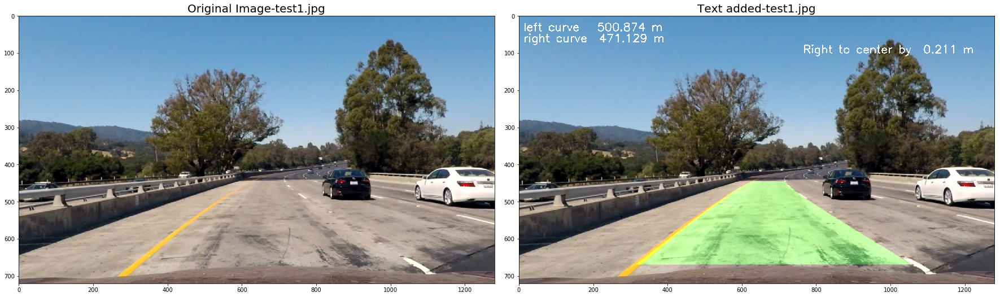

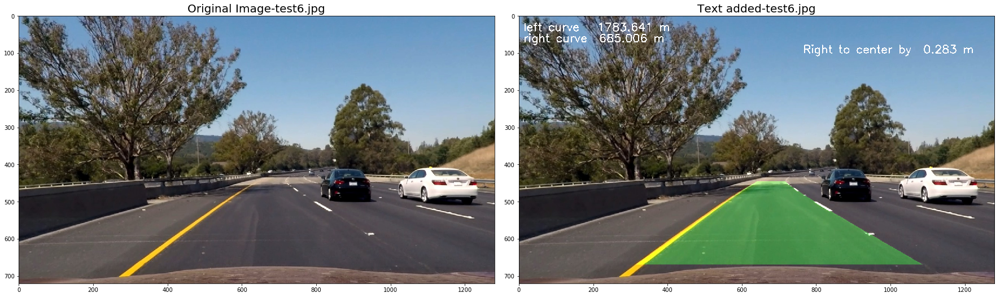

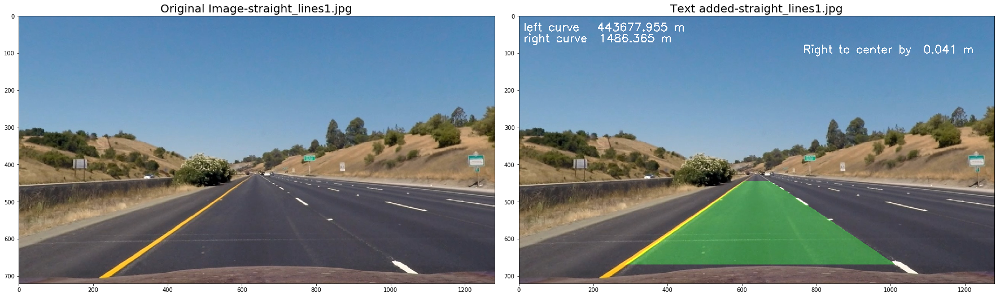

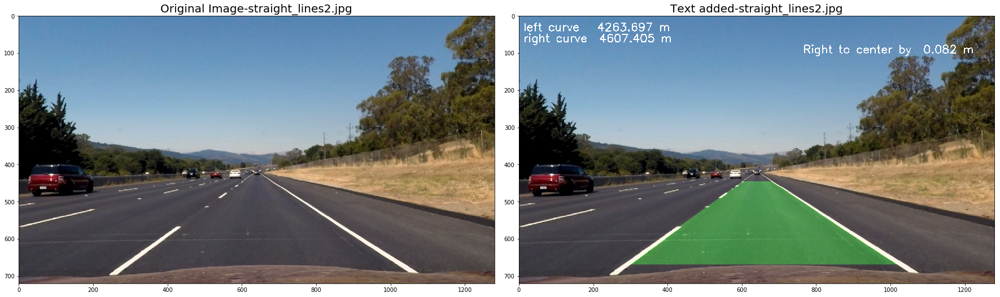

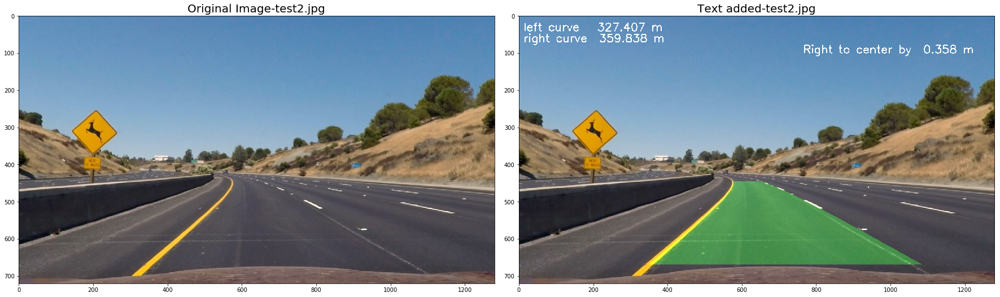

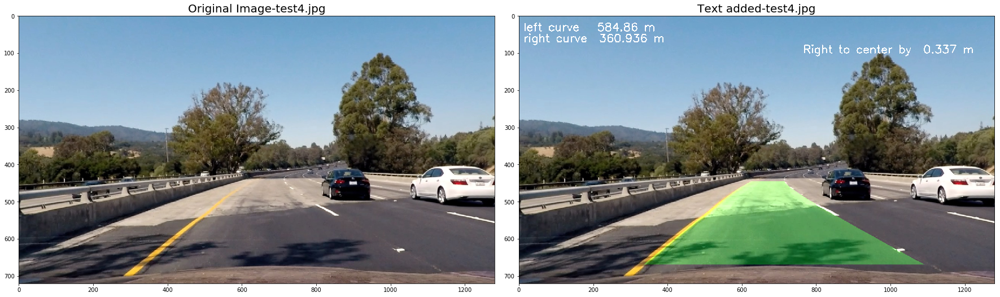

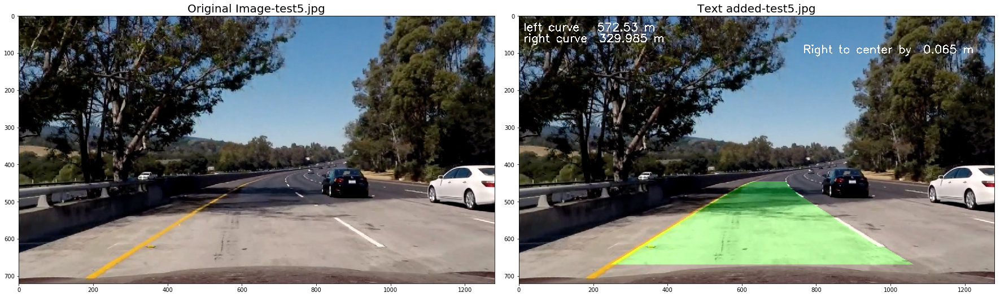

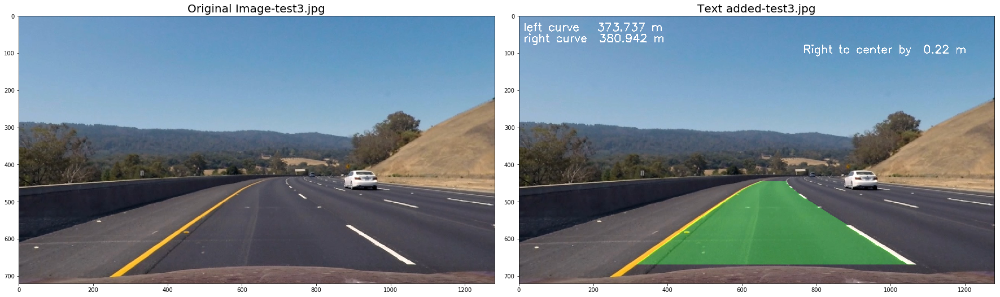

In [28]:
# Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

images = glob.glob('test_images/*.jpg')
output_dst = 'output_images/' 

for path in images:
    image = mpimg.imread(path)
    image = undistort(image)
    combined_binary = color_select(image)
    warped, perspective_M, Revers_M = birds_eye_view(combined_binary)
    ploty, fit_image, left_fit, right_fit, left_fitx, right_fitx = fit_polynomial(warped)
    left_curverad, right_curverad, distancet_to_center = measure_curvature_real(left_fitx, right_fitx, ploty, image)
    result = draw_filling(warped, left_fitx, right_fitx, ploty, image, Revers_M)
    image_name = os.path.basename(path)
    add_text(result, output_dst, image_name, left_curverad, right_curverad, distancet_to_center)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image-'+image_name, fontsize=20)
    # show the result
    ax2.imshow(result)
    ax2.set_title('Text added-'+image_name, fontsize=20)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

In [29]:
# # proccess pipeline
# def process_image(image):
#     image = undistort(image)
#     combined_binary = color_select(image)
#     warped, perspective_M, Revers_M = birds_eye_view(combined_binary)
#     ploty, fit_image, left_fit, right_fit, left_fitx, right_fitx = fit_polynomial(warped)
#     left_curverad, right_curverad, distancet_to_center = measure_curvature_real(left_fitx, right_fitx, ploty, image)
#     result = draw_filling(warped, left_fitx, right_fitx, ploty, image, Revers_M)
#     final = add_text(result, output_dst, image_name, left_curverad, right_curverad, distancet_to_center)
#     return final

### 8. Using buffer
Here with this buffer the last 15 frames are stored and with a help of a temp obejct the use information 
are taken out of line class and its object. The average over the past lane lines is help to smooth the bad frames. Both lane search methods are used. There is a sanity check to make sure that the line are meaningful.

In [30]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line on the left
        self.recent_xfitted_left = deque(maxlen = 15)
        # x values of the last n fits of the line on the right
        self.recent_xfitted_right = deque(maxlen =15)
        #average x values of the fitted line over the last n iterations on the left
        self.bestx_left = None
        #average x values of the fitted line over the last n iterations on the right
        self.bestx_right = None         
        #polynomial coefficients averaged over the last n iterations on the left
        self.best_fit_left = None
        #polynomial coefficients averaged over the last n iterations on the right
        self.best_fit_right = None         
        #polynomial coefficients for the most recent fit on the left
        self.current_fit_left = [np.array([False])]
        #polynomial coefficients for the most recent fit on the right
        self.current_fit_right = [np.array([False])]
        
        # polynomial coefficients for the last n fits for the left lane
        self.recent_fits_left = deque(maxlen =15)
        # polynomial coefficients for the last n fits for the right lane
        self.recent_fits_right = deque(maxlen =15)        
        
        #radius of curvature of the line in some units on the left
        self.radius_of_curvature_left = None
        #radius of curvature of the line in some units on the right
        self.radius_of_curvature_right = None
        #radius of curvature of the line in some units
        self.radius_of_curvature = None         
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits on the left
        self.diffs_left = np.array([0,0,0], dtype='float')
        #difference in fit coefficients between last and new fits on the right
        self.diffs_right = np.array([0,0,0], dtype='float')        
        #x values for detected line pixels on the left
        self.allx_left = None
        #x values for detected line pixels on the right
        self.allx_right = None               
# this returns the object which have the buffer useful information which is needed to hand over later
    def get_temp(self):
        # instance of temp object
        temp = Temp()
        temp.left_fit   = self.best_fit_left
        temp.right_fit  = self.best_fit_right
        temp.left_fitx  = self.best_x_left
        temp.right_fitx = self.best_x_right
        temp.ploty = ploty
        temp.curvature = self.radius_of_curvature
        temp.left_curverad  = self.radius_of_curvature_left
        temp.right_curverad = self.radius_of_curvature_right    
        temp.distancet_to_center = self.line_base_pos
        return temp
# temp initiation
class Temp(object):

    def __init__(self):
        self.left_fit   = None
        self.right_fit  = None 
        self.left_fitx  = None 
        self.right_fitx = None
        self.ploty = None 
        self.curvature = None
        self.right_curverad = None
        self.left_curverad = None
        self.distancet_to_center = None    

In [31]:
# this method uses the histogram info and feed this into search from prior method to save time
# for each new frame there is no need to apply the histogram method
def fit_poly(image_shape, leftx, lefty, rightx, righty):
     ### TO-DO: Fit a second order polynomial to each with np.polyfit() ###
    left_fit  = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, image_shape[0]-1, image_shape[0])
    ### TO-DO: Calc both polynomials using ploty, left_fit and right_fit ###
    left_fitx  = left_fit[0]*ploty**2  + left_fit[1]*ploty  + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return left_fit, right_fit, left_fitx, right_fitx, ploty

def search_from_prior(image, line):
    left_fit  = line.current_fit_left#last frame(best fit)
    right_fit = line.current_fit_right
    
    combined_binary = color_select(image)
    warped, perspective_M, Revers_M = birds_eye_view(combined_binary)
    margin = 100
    
    nonzero  = warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    leftx  = nonzerox[left_lane_inds]
    lefty  = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    left_fit_poly, right_fit_poly, left_fitx, right_fitx, ploty = fit_poly(warped.shape, leftx, lefty, rightx, righty)
    left_curverad, right_curverad, distancet_to_center =  measure_curvature_real(left_fitx, right_fitx, ploty, image)
    
    temp = Temp()
    temp.left_fit   = left_fit_poly
    temp.right_fit  = right_fit_poly
    temp.left_fitx  = left_fitx
    temp.right_fitx = right_fitx
    temp.ploty = ploty
    temp.right_curverad = right_curverad
    temp.left_curverad  = left_curverad
    temp.curvature = smooth_curvature(left_curverad, right_curverad)
    temp.distancet_to_center = distancet_to_center
    return temp

In [32]:
def add_line(line, temp):
    if len(line.recent_xfitted_right) == 0:
        ## If the buffer is empty fill it with the first value.
        line.detected = True
        line.recent_xfitted_left.append(temp.left_fitx)
        line.recent_xfitted_right.append(temp.right_fitx)
        line.recent_fits_left.append(temp.left_fit)
        line.recent_fits_right.append(temp.right_fit)
        line.current_fit_left  = temp.left_fit
        line.current_fit_right = temp.right_fit
        line.best_x_left    = temp.left_fitx
        line.best_x_right   = temp.right_fitx
        line.best_fit_left  = temp.left_fit
        line.best_fit_right = temp.right_fit        
        line.radius_of_curvature_right = temp.right_curverad
        line.radius_of_curvature_left  = temp.left_curverad 
        line.radius_of_curvature = temp.curvature
        line.line_base_pos = temp.distancet_to_center
        line.allx_left  = temp.left_fitx
        line.allx_right = temp.right_fitx
        line.ally = temp.ploty
    else:
        line.detected = True
        line.recent_xfitted_left.append(temp.left_fitx)
        line.recent_xfitted_right.append(temp.right_fitx)
        line.recent_fits_left.append(temp.left_fit)
        line.recent_fits_right.append(temp.right_fit)        
        line.best_x_left    = np.mean(np.array(line.recent_xfitted_left),axis=0)
        line.best_x_right   = np.mean(np.array(line.recent_xfitted_right),axis=0)
        line.best_fit_left  = np.mean(np.array(line.recent_fits_left),axis=0)
        line.best_fit_right = np.mean(np.array(line.recent_fits_right),axis=0)
        line.current_fit_left  = temp.left_fit
        line.current_fit_right = temp.right_fit
        #--------
        line.diffs_left  = np.absolute(line.current_fit_left - temp.left_fit) 
        line.diffs_right = np.absolute(line.current_fit_right - temp.right_fit)
        #--------
        line.radius_of_curvature = temp.curvature
        line.radius_of_curvature_right = temp.right_curverad
        line.radius_of_curvature_left  = temp.left_curverad 
        line.line_base_pos = temp.distancet_to_center
        line.allx_left  = temp.left_fitx
        line.allx_right = temp.right_fitx
        line.ally = temp.ploty
    return line

In [49]:
# the curverad information and vehicle position in regard to image center are shown
def add_text_video(result, left_curverad, right_curverad, distancet_to_center):
    offset     = 30
    font       = cv2.FONT_HERSHEY_SIMPLEX
    first_line = (12,10)
    fontScale  = 1
    fontColor  = (255,255,255)
    lineType   = 2
    text = ['left curve   ' + str(round(left_curverad, 3))  +' m',
            'right curve  ' + str(round(right_curverad, 3)) +' m']
    
    if distancet_to_center > 0:
        text.append('                                           Right to center by  ' + str(round(distancet_to_center, 3) )+' m')
    if distancet_to_center < 0:
        text.append('Left to center by  '  + str(round(abs(distancet_to_center), 3) )+' m')        
    if distancet_to_center == 0:
        text.append('                         CENTERD')    

    for i in np.arange(3):#  0 1 2
        first_line = (first_line[0],first_line[1] + offset)
        cv2.putText(result,text[i], first_line, font, fontScale, fontColor, lineType)
    return result

In [50]:
# the search result for the lane lines is finally are added to the image
def draw_lines(image, temp):
    undist = undistort(image)
    gray = cv2.cvtColor(undist, cv2.COLOR_BGR2GRAY)
    warped, perspective_M, Revers_M = birds_eye_view(gray)
    temp_image = np.zeros_like(warped).astype(np.uint8)
    foto = np.dstack((temp_image, temp_image, temp_image))
    image_size = (image.shape[1], image.shape[0])
    left_fitx = temp.left_fitx
    right_fitx = temp.right_fitx
    ploty = temp.ploty
    left_points = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    right_points = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    points = np.hstack((left_points, right_points))
    cv2.fillPoly(foto, np.int_([points]), (0,255, 0))
    newwarp = cv2.warpPerspective(foto, Revers_M, image_size) 
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    # add the information to image
    result = add_text_video(result, temp.left_curverad, temp.right_curverad, temp.distancet_to_center)
    return result

In [51]:
# this uses histogram-based, lane finding method to define the curvrad and feed them into temp
def find_lane(image):
    image = undistort(image)
    combined_binary = color_select(image)
    warped, perspective_M, Revers_M = birds_eye_view(combined_binary)
    ploty, fit_image, left_fit, right_fit, left_fitx, right_fitx = fit_polynomial(warped)
    left_curverad, right_curverad, distancet_to_center = measure_curvature_real(left_fitx, right_fitx, ploty, image)
        
    temp = Temp()
    temp.left_fit = left_fit
    temp.right_fit = right_fit
    temp.left_fitx = left_fitx
    temp.right_fitx = right_fitx
    temp.ploty = ploty
    temp.right_curverad = right_curverad
    temp.left_curverad = left_curverad
    temp.curvature = smooth_curvature(left_curverad, right_curverad)
    temp.distancet_to_center = distancet_to_center
    return temp, perspective_M, Revers_M

In [52]:
# to test if the detected line for each frame making any sense
def sanity(temp, line):
    xm_per_pix = 3.7/700
    lane_width = abs(temp.left_fitx[-1] - temp.right_fitx[-1]) * xm_per_pix
    MAX_ACCEPTABLE_WIDTH = 1.0 # meter
    if np.abs(lane_width - 3.7) > MAX_ACCEPTABLE_WIDTH:
        return False
    dif = np.abs((temp.left_curverad - temp.right_curverad) / temp.left_curverad)
    MAX_ACCEPTABLE_PARALEL = 5.0 # percent
    if dif > MAX_ACCEPTABLE_PARALEL:
        return False
    deviation  = np.abs(temp.distancet_to_center - line.line_base_pos)
    MAX_ACCEPTABLE_LINE_MOVED = .2 # meter
    if deviation  > MAX_ACCEPTABLE_LINE_MOVED:
        return False
    return True

In [53]:
def final(image, **pass_in_var):
    line = pass_in_var["line"]
    if len(line.recent_xfitted_right) == 0:
        temp, perspective_M, Revers_M = find_lane(image)
        add_line(line, temp)
    else:
        temp = search_from_prior(image, line)
        if sanity(temp, line):
            add_line(line, temp)
    temp = line.get_temp()
    return draw_lines(image, temp)

# the last 15 iteration out of buffer handing over to variable to insert into final pipeline
line = Line()
pass_in_var = {"line":line}

def process_image(image):
    
    return final(image, ** pass_in_var)

In [54]:
imageio.plugins.ffmpeg.download()

project_video = 'test_videos_output/project_video.mp4'

clip1 = VideoFileClip('project_video.mp4')
project_video_clip = clip1.fl_image(process_image)
%time project_video_clip.write_videofile(project_video, audio=False)

[MoviePy] >>>> Building video test_videos_output/project_video.mp4
[MoviePy] Writing video test_videos_output/project_video.mp4


100%|█████████▉| 1260/1261 [04:46<00:00,  4.40it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_videos_output/project_video.mp4 

CPU times: user 9min 58s, sys: 1min 23s, total: 11min 21s
Wall time: 4min 47s


### Discussion

I had a hard time to make my code work on challenge videos. My pipeline faild mostley where it could not detect any pixel due to surface contrast and also shadows. The sobel line detection causes many noises and it detects even dark tar marks or braking marks on the raod.
I should work harder to enhance my vision code to detect more pixels out of lane lines. There is a way to omit unwanted lines gained over sobel. Sanity check could be more enhanced to tackle those problems also.
I should work to make the sliding windows code more sophisticated to handle the harder challenge curves.


In [39]:
# challenge_video = 'test_videos_output/challenge_video.mp4'

# clip2 = VideoFileClip('challenge_video.mp4')
# challenge_video_clip = clip2.fl_image(process_image)
# %time challenge_video_clip.write_videofile(challenge_video, audio=False)

In [40]:
# HTML("""
# <video width="960" height="540" controls>
#   <source src="{0}">
# </video>
# """.format(challenge_video))

In [41]:
# harder_challenge_video = 'test_videos_output/harder_challenge_video.mp4'

# clip3 = VideoFileClip('harder_challenge_video.mp4')
# harder_challenge_video_clip = clip3.fl_image(process_image)
# %time harder_challenge_video_clip.write_videofile(harder_challenge_video, audio=False)

In [42]:
# HTML("""
# <video width="960" height="540" controls>
#   <source src="{0}">
# </video>
# """.format(harder_challenge_video))